<a href="https://colab.research.google.com/github/nabdelouali/FMCW_Radar/blob/main/fft_dual_phasor_animation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [94]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML, display
import matplotlib.gridspec as gridspec

plt.rcParams['animation.embed_limit'] = 50

# ---- Définition de la Palette de Couleurs ----
colors = {
    'black': '#333333', # Darker black for better contrast
    'soft_grey': '#D9D9D9',
    'muted_blue': '#4682B4', # A clearer blue
    'red_ti': '#C41E3A',    # A strong red
    'dark_blue_dashed': '#00008B',
    'white': '#FFFFFF',
    'beige': '#F5F2E0'
}
# Le style ggplot est une bonne base, mais nous allons le personnaliser.
plt.style.use('ggplot')

In [95]:
# ---- Paramètres de l'animation ----
A1 = 0.8
omega1 = 2 * np.pi / 50
A2 = 0.6
omega2 = 2 * np.pi / 25
num_frames = 150
Fs = 1 # Sampling frequency is 1 sample per frame
ZERO_PADDING_FACTOR = 8 # **NEW**: Increase for a smoother FFT plot

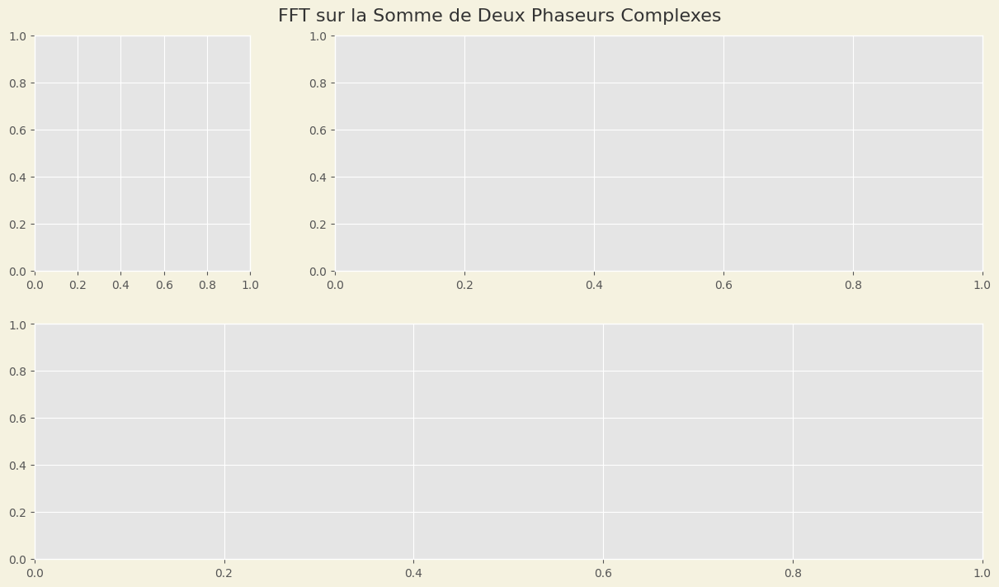

In [96]:
# ---- Création de la Figure et des Axes avec la nouvelle disposition ----
fig = plt.figure(figsize=(12, 7), constrained_layout=True) # Taille ajustée pour la nouvelle disposition
fig.patch.set_facecolor(colors['beige'])
fig.suptitle("FFT sur la Somme de Deux Phaseurs Complexes", fontsize=16, color=colors['black'])

gs = gridspec.GridSpec(2, 2, figure=fig,
                       width_ratios=[1, 3],  # Tweak this ratio as needed (e.g., [1, 1.5] or [1, 2])
                       height_ratios=[1, 1],
                       wspace=0.05,           # Increase/decrease for horizontal space
                       hspace=0.1)           # Increase/decrease for vertical space

ax_phasor = fig.add_subplot(gs[0, 0]) # Ligne 0, Colonne 0
ax_time = fig.add_subplot(gs[0, 1])   # Ligne 0, Colonne 1
ax_fft = fig.add_subplot(gs[1, :])    # Ligne 1, Colonnes 0 et 1 fusionnées (span)

In [97]:
# --- Configuration de l'axe du Phaseur (ax_phasor) ---
ax_phasor.set_facecolor(colors['soft_grey'])
ax_phasor.set_aspect('equal')
ax_phasor.set_xlim(-(A1 + A2) * 1.1, (A1 + A2) * 1.1)
ax_phasor.set_ylim(-(A1 + A2) * 1.1, (A1 + A2) * 1.1)
ax_phasor.set_xlabel("Partie Réelle (Re)", color=colors['black'])
ax_phasor.set_ylabel("Partie Imaginaire (Im)", color=colors['black'])
ax_phasor.set_title("Deux Phaseurs Tournants", color=colors['black'], fontsize=10)
ax_phasor.grid(True, color=colors['white'], linestyle='-', linewidth=0.7)

# Phasor arrows and dots
phasor1_arrow, = ax_phasor.plot([], [], color=colors['muted_blue'], lw=1.5, label=f"Ph.1 (ω₁≈{omega1:.2f})")
phasor1_dot, = ax_phasor.plot([], [], 'o', color=colors['muted_blue'], markersize=5)
phasor2_arrow, = ax_phasor.plot([], [], color=colors['red_ti'], lw=1.5, label=f"Ph.2 (ω₂≈{omega2:.2f})")
phasor2_dot, = ax_phasor.plot([], [], 'o', color=colors['red_ti'], markersize=5)

# **NEW**: Add trails to show discrete history of phasors
phasor1_trail, = ax_phasor.plot([], [], 'o', color=colors['muted_blue'], alpha=0.3, markersize=2)
phasor2_trail, = ax_phasor.plot([], [], 'o', color=colors['red_ti'], alpha=0.3, markersize=2)

legend_phasor = ax_phasor.legend(loc='upper right', fontsize='x-small')
legend_phasor.get_frame().set_facecolor(colors['beige'])
legend_phasor.get_frame().set_edgecolor(colors['soft_grey'])
for text in legend_phasor.get_texts(): text.set_color(colors['black'])

ax_phasor.tick_params(axis='x', colors=colors['black'], labelsize='small')
ax_phasor.tick_params(axis='y', colors=colors['black'], labelsize='small')
# **CHANGED**: Set spine color to black
for spine in ax_phasor.spines.values(): spine.set_edgecolor(colors['black'])

# --- Configuration de l'axe du Signal Temporel (ax_time) ---
ax_time.set_facecolor(colors['soft_grey'])
ax_time.set_xlim(0, num_frames)
ax_time.set_ylim(-(A1 + A2) * 1.1, (A1 + A2) * 1.1)
ax_time.set_xlabel("Temps (indice k)", color=colors['black'])
ax_time.set_ylabel("Re{signal}", color=colors['black'])
ax_time.set_title("Signaux Temporels & Somme", color=colors['black'], fontsize=10)
ax_time.grid(True, color=colors['white'], linestyle='-', linewidth=0.7)

# **CHANGED**: Use 'o-' to plot both markers and lines for discreteness
time_signal1_line, = ax_time.plot([], [], 'o-', color=colors['muted_blue'], lw=1.5, markersize=3, label="Re{s₁}")
time_signal2_line, = ax_time.plot([], [], 'o-', color=colors['red_ti'], lw=1.5, markersize=3, label="Re{s₂}")
time_signal_sum_line, = ax_time.plot([], [], 'o-', color=colors['black'], lw=1.0, markersize=3, alpha=0.6, label="Somme")

legend_time = ax_time.legend(loc='upper right', fontsize='x-small')
legend_time.get_frame().set_facecolor(colors['beige'])
legend_time.get_frame().set_edgecolor(colors['soft_grey'])
for text in legend_time.get_texts(): text.set_color(colors['black'])

ax_time.tick_params(axis='x', colors=colors['black'], labelsize='small')
ax_time.tick_params(axis='y', colors=colors['black'], labelsize='small')
# **CHANGED**: Set spine color to black
for spine in ax_time.spines.values(): spine.set_edgecolor(colors['black'])


# --- Configuration de l'axe de la FFT (ax_fft) ---
ax_fft.set_facecolor(colors['soft_grey'])
ax_fft.set_xlabel("Fréquence Angulaire Discrète (ω) [rad/éch.]", color=colors['black'])
ax_fft.set_ylabel("Amplitude FFT Normalisée", color=colors['black'])
ax_fft.set_title("Transformée de Fourier Discrète (FFT)", color=colors['black'], fontsize=10)
ax_fft.set_xlim(0, np.pi) # Frequencies range from 0 to Nyquist (pi)
ax_fft.set_ylim(0, max(A1, A2) * 1.2)
ax_fft.grid(True, color=colors['white'], linestyle='-', linewidth=0.7)

# **NEW**: Create a single line object for the dynamic FFT plot
fft_line, = ax_fft.plot([], [], color=colors['red_ti'], lw=1.5, label='FFT de la Somme')

legend_fft = ax_fft.legend(loc='upper right', fontsize='x-small')
legend_fft.get_frame().set_facecolor(colors['beige'])
legend_fft.get_frame().set_edgecolor(colors['soft_grey'])
for text in legend_fft.get_texts(): text.set_color(colors['black'])

ax_fft.tick_params(axis='x', colors=colors['black'], labelsize='small')
ax_fft.tick_params(axis='y', colors=colors['black'], labelsize='small')
# **CHANGED**: Set spine color to black
for spine in ax_fft.spines.values(): spine.set_edgecolor(colors['black'])

# --- Data storage for animation ---
time_data_x = []
time_data_y1_real = []
time_data_y2_real = []
time_data_y_sum_real = []
complex_signal_sum = []
phasor1_history_x, phasor1_history_y = [], []
phasor2_history_x, phasor2_history_y = [], []


In [98]:
# ---- Fonction de mise à jour pour l'animation ----
def update(frame_num):
    if frame_num == 0:
        # Clear all data lists at the start
        time_data_x.clear(); time_data_y1_real.clear(); time_data_y2_real.clear()
        time_data_y_sum_real.clear(); complex_signal_sum.clear()
        phasor1_history_x.clear(); phasor1_history_y.clear()
        phasor2_history_x.clear(); phasor2_history_y.clear()

    # --- 1. Calculate Phasor Positions & Update Time Plots ---
    s1 = A1 * np.exp(1j * omega1 * frame_num)
    s2 = A2 * np.exp(1j * omega2 * frame_num)
    signal_sum = s1 + s2

    phasor1_arrow.set_data([0, s1.real], [0, s1.imag]); phasor1_dot.set_data([s1.real], [s1.imag])
    phasor2_arrow.set_data([0, s2.real], [0, s2.imag]); phasor2_dot.set_data([s2.real], [s2.imag])

    phasor1_history_x.append(s1.real); phasor1_history_y.append(s1.imag)
    phasor2_history_x.append(s2.real); phasor2_history_y.append(s2.imag)
    phasor1_trail.set_data(phasor1_history_x, phasor1_history_y)
    phasor2_trail.set_data(phasor2_history_x, phasor2_history_y)

    time_data_x.append(frame_num)
    time_data_y1_real.append(s1.real)
    time_data_y2_real.append(s2.real)
    time_data_y_sum_real.append(signal_sum.real)
    complex_signal_sum.append(signal_sum)

    time_signal1_line.set_data(time_data_x, time_data_y1_real)
    time_signal2_line.set_data(time_data_x, time_data_y2_real)
    time_signal_sum_line.set_data(time_data_x, time_data_y_sum_real)

    # --- 2. **NEW**: Clear and Redraw FFT Plot ---
    ax_fft.clear() # Clear the entire subplot for redrawing

    N = len(complex_signal_sum)
    if N > 1:
        # Calculate zero-padded FFT for a smooth curve
        fft_length = N * ZERO_PADDING_FACTOR
        yf = np.fft.fft(complex_signal_sum, n=fft_length)
        xf = 2 * np.pi * np.fft.fftfreq(fft_length, 1/Fs)

        # Plot only positive frequencies
        positive_freq_indices = np.where(xf >= 0)
        xf_pos = xf[positive_freq_indices]
        yf_pos_mag = np.abs(yf[positive_freq_indices]) / N # Normalize amplitude

        # Plot the filled area and the outline
        ax_fft.fill_between(xf_pos, yf_pos_mag, color=colors['black'], alpha=0.4, label='FFT Calculée')
        ax_fft.plot(xf_pos, yf_pos_mag, color=colors['black'], lw=2.0)

    # --- 3. **NEW**: Re-apply formatting and peak indicators to FFT plot ---
    ax_fft.set_title("Transformée de Fourier Discrète (FFT Calculée)", color=colors['black'], fontsize=12)
    ax_fft.set_xlabel("Fréquence Angulaire Discrète (ω) [rad/éch.]", color=colors['black'])
    ax_fft.set_ylabel("Amplitude FFT", color=colors['black'])
    ax_fft.set_xlim(0, np.pi)
    ax_fft.set_ylim(0, max(A1, A2) * 1.5) # A bit more space for overshoot
    ax_fft.grid(True, color=colors['white'], linestyle='-', linewidth=0.7)

    # Add vertical lines for ideal peaks
    ideal_peak1 = ax_fft.axvline(x=omega1, color=colors['muted_blue'], linestyle='--', lw=2, label=f'Pic Idéal ω₁≈{omega1:.2f}')
    ideal_peak2 = ax_fft.axvline(x=omega2, color=colors['red_ti'], linestyle='--', lw=2, label=f'Pic Idéal ω₂≈{omega2:.2f}')

    # Add custom ticks at peak locations
    custom_ticks = list(ax_fft.get_xticks())
    custom_ticks.extend([omega1, omega2])
    custom_ticks = sorted(list(set(t for t in custom_ticks if t <= np.pi))) # Remove duplicates and out-of-bounds
    ax_fft.set_xticks(custom_ticks)
    ax_fft.tick_params(axis='x', colors=colors['black'], labelsize='small', rotation=30)
    ax_fft.tick_params(axis='y', colors=colors['black'], labelsize='small')

    legend_fft = ax_fft.legend(handles=[plt.Line2D([0], [0], color=colors['black'], lw=2, label='FFT Calculée'), ideal_peak1, ideal_peak2], loc='upper right')
    legend_fft.get_frame().set_facecolor(colors['beige'])
    for text in legend_fft.get_texts(): text.set_color(colors['black'])
    for spine in ax_fft.spines.values(): spine.set_edgecolor(colors['black'])

    return (phasor1_arrow, phasor1_dot, phasor1_trail,
            phasor2_arrow, phasor2_dot, phasor2_trail,
            time_signal1_line, time_signal2_line, time_signal_sum_line)


In [99]:
# ---- Création de l'animation ----
# **IMPORTANT**: blit=False is required because the number of points in the FFT plot changes each frame.
ani = animation.FuncAnimation(fig, update, frames=num_frames,
                              blit=False, interval=60, repeat=True)

# Adjust layout to prevent labels/titles from overlapping
# fig.tight_layout(rect=[0, 0, 1, 0.96]) # rect leaves space for suptitle
# ---- Affichage dans Colab ----
try:
    html_output = ani.to_jshtml()
    plt.close(fig)
    display(HTML(html_output))
except Exception as e:
    print(f"Erreur lors de la création de l'animation HTML : {e}")

In [100]:
ani.save('animation_fft_3.mp4', writer='ffmpeg', dpi=150)